Test the two step prediction model with new images

In [48]:
import os
import sys
import pandas as pd
import pickle
import random 

from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

sys.path.append('../')

import helper_dataset

pilot2_path='/nfs/juhu/data/rakhasan/bystander-detection/pilot-study2/'
pilot3_path='/nfs/juhu/data/rakhasan/bystander-detection/pilot3_coco/'

In [49]:
features_from_study = ['was_aware_num',  'posing_num',  'comfort_num',  'will_num', 'photographer_intention_num',
     'replacable_num',  'photo_place_num']
img_level_features = ['person_distance', 'person_size', 'num_people']

all_predictors=['predicted_will', 'predicted_comfort', 'predicted_aware',
       'predicted_posing', 'predicted_replace', 'predicted_intention']+features_from_study+img_level_features

predictors = ['predicted_aware','person_size','replacable_num','photographer_intention_num']

## Test with train+test split

In [50]:
'''Load predicted-high level features'''
df = pd.read_pickle(os.path.join(pilot2_path, 'predicted-concepts-df-2020-1-12.pkl'))

In [51]:
df.head()

,predicted_will,predicted_comfort,predicted_aware,predicted_posing,predicted_replace,predicted_intention,label,was_aware_num,posing_num,comfort_num,will_num,photographer_intention_num,replacable_num,photo_place_num,person_distance,person_size,num_people
photo_no,,,,,,,,,,,,,,,,,
1,1.247788,1.652887,2.459248,1.371118,-1.719669,1.318527,1,2.500000,2.000000,2.000000,1.500000,2.50,-2.50,2.000000,0.116905,0.622600,1
10,0.351593,0.567239,-1.711195,-1.648413,2.704367,-1.082630,0,-1.333333,-1.333333,1.666667,1.333333,-2.00,3.00,-1.666667,0.326488,0.002456,4
100,0.501304,0.269002,0.144437,-0.989171,-0.066443,0.776461,1,0.750000,0.000000,0.500000,0.500000,1.25,-0.25,1.250000,0.261331,0.104219,1
1000,1.540396,1.979436,1.392768,1.018057,-1.527403,-1.811628,1,2.000000,1.750000,2.500000,2.000000,-2.25,-2.25,-1.000000,0.029659,0.275583,3
1001,0.815081,1.055310,0.424932,-0.102550,1.183310,-0.146204,0,1.500000,0.000000,1.500000,1.000000,-0.25,1.25,-2.000000,0.327691,0.021361,2


In [52]:
'''Test the model'''
X_train, X_test, y_train, y_test = train_test_split(df[predictors], df.label, test_size=0.20, random_state=42)

In [53]:
clf = LogisticRegression(random_state=0).fit(X_train, y_train)

/nfs/juhu/data/rakhasan/keras-env/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)


In [54]:
predictions = clf.predict(X_test)

In [8]:
res = y_test.to_frame()
res['predicted']=predictions
res['correct']=res.apply(lambda row: row.predicted==row.label,axis=1)
print(100*len(res[res.correct])/len(res))
res

82.84313725490196


,label,predicted,correct
photo_no,,,
1038,1,1,True
4616,0,0,True
2703,0,0,True
3788,1,0,False
152,0,0,True
...,...,...,...
527,0,0,True
1075,1,1,True
2847,0,0,True


In [9]:
res = y_test.to_frame()
res['predicted']=predictions
res['correct']=res.apply(lambda row: row.predicted==row.label,axis=1)
print(100*len(res[res.correct])/len(res))
res

82.84313725490196


,label,predicted,correct
photo_no,,,
1038,1,1,True
4616,0,0,True
2703,0,0,True
3788,1,0,False
152,0,0,True
...,...,...,...
527,0,0,True
1075,1,1,True
2847,0,0,True


In [23]:
'''F1 score'''
val=0
TP = len(res[(res.label==val)&(res.predicted==val)])
FP = len(res[(res.label==1-val)&(res.predicted==val)])
FN = len(res[(res.label==val)&(res.predicted==1-val)])
precision=TP/(TP+FP)
recall=TP/(TP+FN)
f1= 2*precision*recall/(precision+recall)
f1

0.801699716713881

In [10]:
res.loc[['1882', '1360', '1378', '2345', '3854', '1184', '2702', '989', '3418', '3387', '2249', '1561', '4727', '4328', '669', '3459']]

,label,predicted,correct
photo_no,,,
1882,1,1,True
1360,1,1,True
1378,0,0,True
2345,0,0,True
3854,1,1,True
1184,0,0,True
2702,1,1,True
989,1,1,True
3418,0,0,True


photo_no
1253    0
835     1
2964    1
4223    1
189     0
3441    0
4657    1
1056    0
2461    0
2087    0
2485    0
857     1
4563    1
1548    1
2991    1
2929    1
Name: label, dtype: int64
4 4


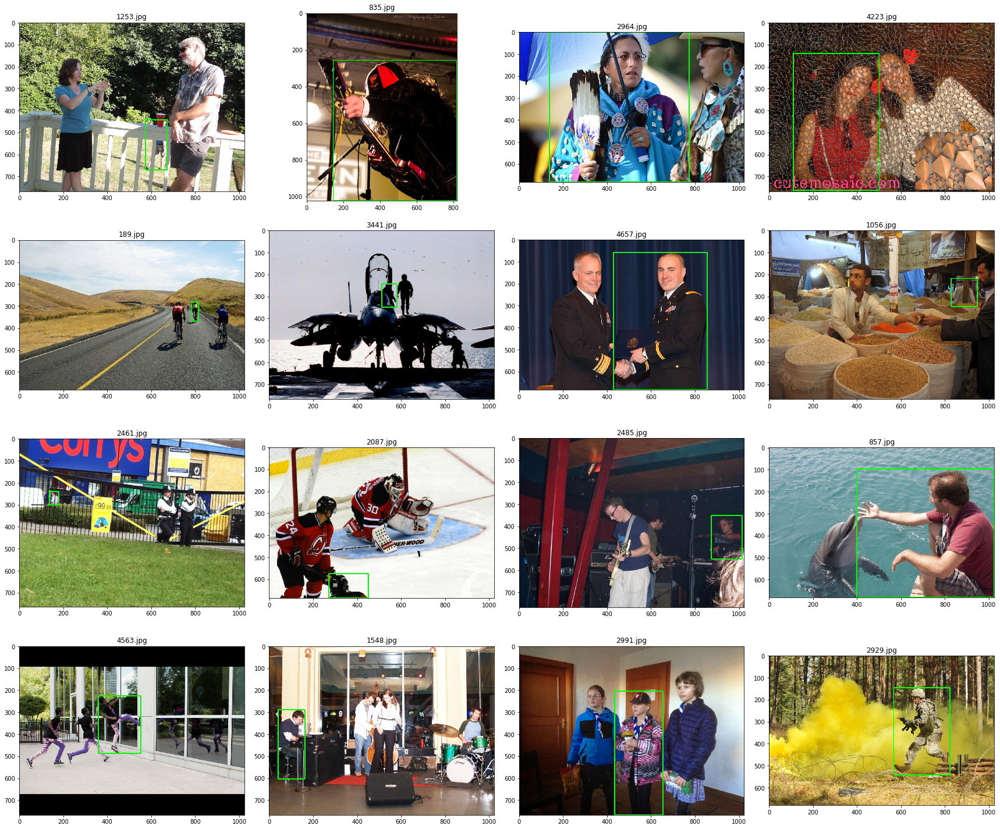

In [84]:
'''show some correct images'''
photos = random.sample(list(res[res.correct].index), 16)
print(res.loc[photos].label)
photos=['{}/{}.jpg'.format(pilot2_img_path,p) for p in photos]
helper_dataset.draw_photos_from_path(photos, col_size=4)

photo_no
1852    1
786     0
3426    0
2918    1
58      0
3572    1
3788    1
1774    1
1122    0
736     1
3539    1
614     0
3502    1
540     0
4844    1
1551    0
Name: label, dtype: int64
4 4


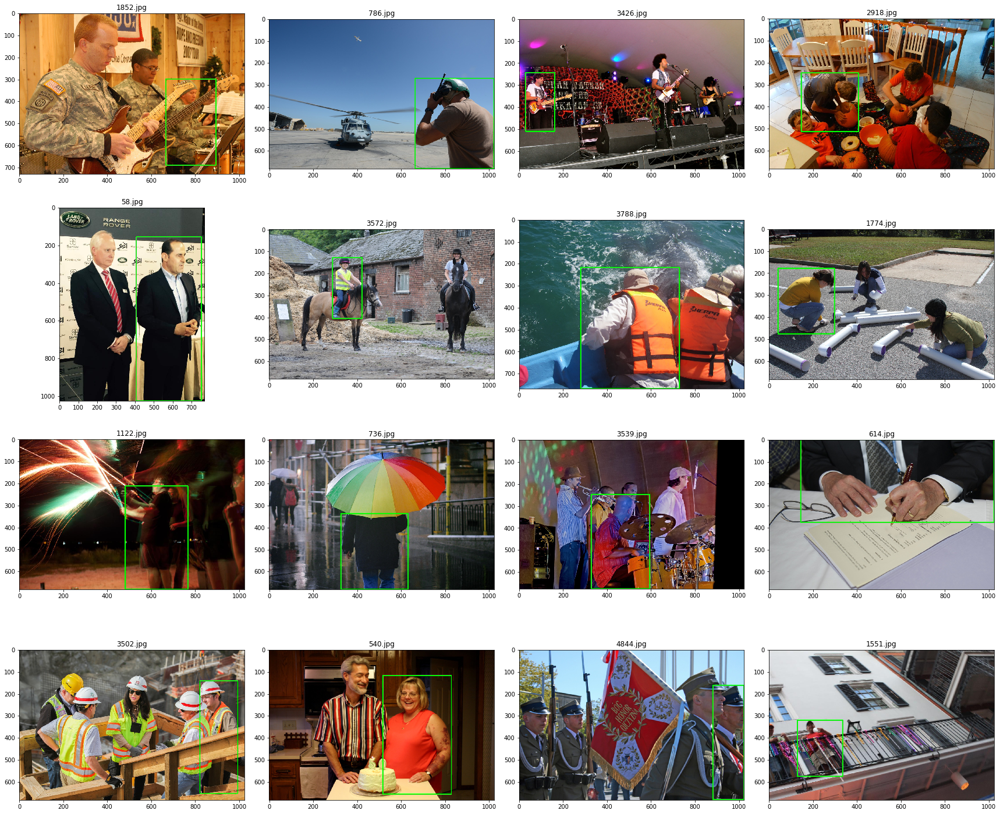

In [85]:
'''Show some wrong images'''
photos = random.sample(list(res[res.correct==False].index), 16)
print(res.loc[photos].label)
photos=['{}/{}.jpg'.format(pilot2_img_path,p) for p in photos]
helper_dataset.draw_photos_from_path(photos, col_size=4)

## Test with new data

In [24]:
train_df = pd.read_pickle(os.path.join(pilot2_path, 'predicted-concepts-df-2020-1-12.pkl'))
train_df.index=train_df.index.astype(int)

In [25]:
test_df = pd.read_pickle(os.path.join(pilot3_path, 'predicted-concepts-df.pkl'))
df= pd.read_pickle(os.path.join(pilot3_path,'3-response-df.pkl'))           
print(test_df.shape)
test_df=test_df.loc[set(test_df.index).intersection(set(range(703)))]
#test_df=test_df.loc[set(test_df.index).intersection(set(df.index))]
print(test_df.shape)

(736, 15)
(600, 15)


In [26]:
print('\n\nPos:{}({:.2f}%)\nNeg:{}({:.2f}%)'.format(
    len(test_df[test_df.label==1]), len(test_df[test_df.label==1])*100/len(test_df),
     len(test_df[test_df.label==0]), len(test_df[test_df.label==0])*100/len(test_df)))



Pos:354(59.00%)
Neg:246(41.00%)


In [27]:
clf = LogisticRegression(random_state=0).fit(train_df[predictors], train_df.label)
predictions = predictions = clf.predict(test_df[predictors])

/nfs/juhu/data/rakhasan/keras-env/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)


In [28]:
res = test_df[['label']]
res['predicted']=predictions
res['correct']=res.apply(lambda row: row.predicted==row.label,axis=1)
print(100*len(res[res.correct])/len(res))

85.0


/nfs/juhu/data/rakhasan/keras-env/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/nfs/juhu/data/rakhasan/keras-env/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [36]:
2*.9*.83/(.9+.83)

0.8635838150289017

In [31]:
'''F1 score'''
val=1
TP = len(res[(res.label==val)&(res.predicted==val)])
FP = len(res[(res.label==1-val)&(res.predicted==val)])
FN = len(res[(res.label==val)&(res.predicted==1-val)])
precision=TP/(TP+FP)
recall=TP/(TP+FN)
f1= 2*precision*recall/(precision+recall)
precision,recall,f1

(0.9074074074074074, 0.8305084745762712, 0.8672566371681415)

In [78]:
print(get_same_img_indices([922,24],mapping_coco))
res.loc[[252, 587, 922,24,224,424,624,824]]

defaultdict(<class 'list'>, {535289: [252, 587, 922], 488862: [24, 224, 424, 624, 824]})


/nfs/juhu/data/rakhasan/keras-env/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  


,label,predicted,correct
photo_no,,,
252,1.0,1.0,True
587,1.0,1.0,True
922,NaN,NaN,NaN
24,1.0,1.0,True
224,0.0,0.0,True
424,1.0,1.0,True
624,0.0,0.0,True
824,NaN,NaN,NaN


In [76]:
res[res.correct==False]

,label,predicted,correct
photo_no,,,
6,0,1,False
8,1,0,False
13,1,0,False
23,0,1,False
25,1,0,False
...,...,...,...
650,1,0,False
658,1,0,False
668,1,0,False


### Compare with humans

In [260]:
low=pickle.load(open(pilot3_path+'low-agreement.pkl','rb'))
mid=pickle.load(open(pilot3_path+'agreement23.pkl','rb'))
high=pickle.load(open(pilot3_path+'agreement100.pkl','rb'))
len(low),len(mid),len(high)

(62, 197, 419)

In [261]:
low = list(set(low).intersection(set(test_df.index)))
mid = list(set(mid).intersection(set(test_df.index)))
high = list(set(high).intersection(set(test_df.index)))
for index in [low,high,mid]:
    predictions = clf.predict(test_df.loc[index][predictors])
    res = test_df.loc[index][['label']]
    res['predicted']=predictions
    res['correct']=res.apply(lambda row: row.predicted==row.label,axis=1)
    print('Total: {}, correct:{:.2f}'.format(len(predictions),100*len(res[res.correct])/len(res)))

Total: 59, correct:61.02
Total: 354, correct:91.24
Total: 168, correct:78.57


In [263]:
168/600

0.28

photo_no
200    1
165    1
428    0
359    0
196    0
7      1
491    1
419    0
416    1
700    1
323    0
670    1
265    1
533    0
655    1
317    1
Name: label, dtype: int64
4 4


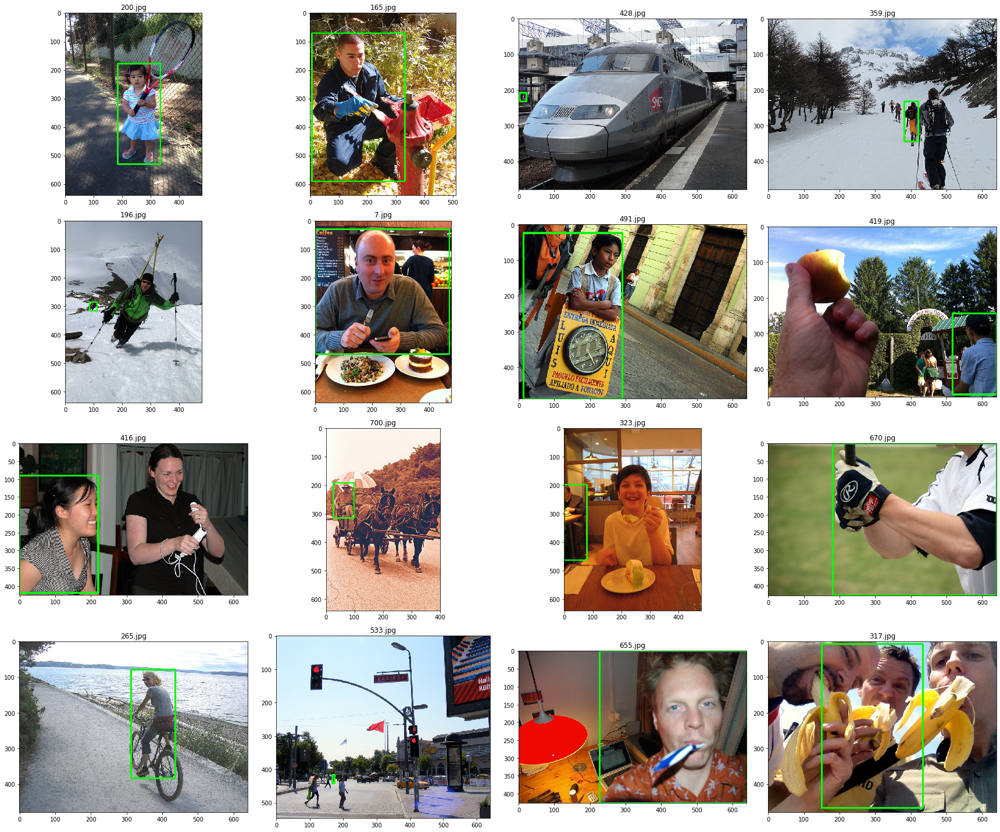

In [144]:
'''show some correct images'''
photos = random.sample(list(res[res.correct].index), 16)
print(res.loc[photos].label)
photos=['{}/{}.jpg'.format(pilot3_path+'/photos/',p) for p in photos]
helper_dataset.draw_photos_from_path(photos, col_size=4)

In [145]:
get_same_img_indices([533,214,433],mapping_coco)
#get_same_img_indices([74],mapping_coco)

defaultdict(list,
            {569308: [33, 283, 533, 783],
             247726: [14, 214, 414, 614, 814],
             385744: [183, 433, 683, 933]})

2 4


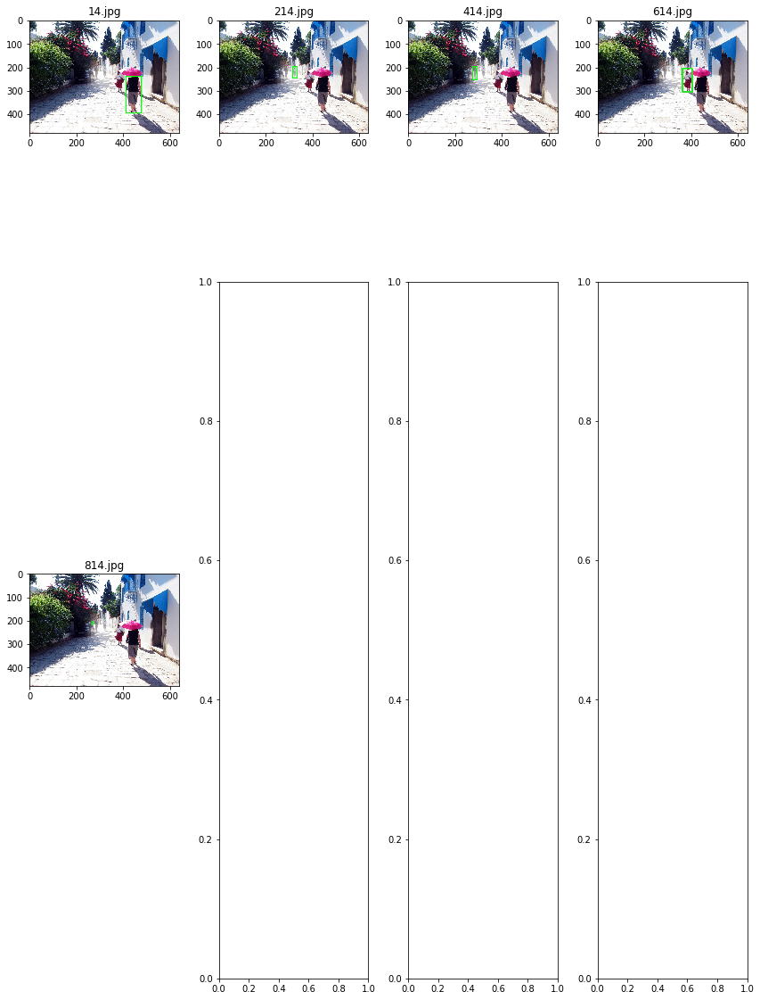

In [142]:
photos=['{}/{}.jpg'.format(pilot3_path+'/photos/',p) for p in [14, 214, 414, 614, 814]]
helper_dataset.draw_photos_from_path(photos, col_size=4)

In [146]:
res.loc[[33, 283, 533, 783]]

/nfs/juhu/data/rakhasan/keras-env/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  """Entry point for launching an IPython kernel.


,label,predicted,correct
photo_no,,,
33,0.0,0.0,True
283,0.0,0.0,True
533,0.0,0.0,True
783,NaN,NaN,NaN


photo_no
45     1
542    0
159    1
305    1
188    1
263    0
668    1
216    1
139    1
324    1
615    1
327    1
410    0
88     0
672    1
254    0
Name: label, dtype: int64
4 4


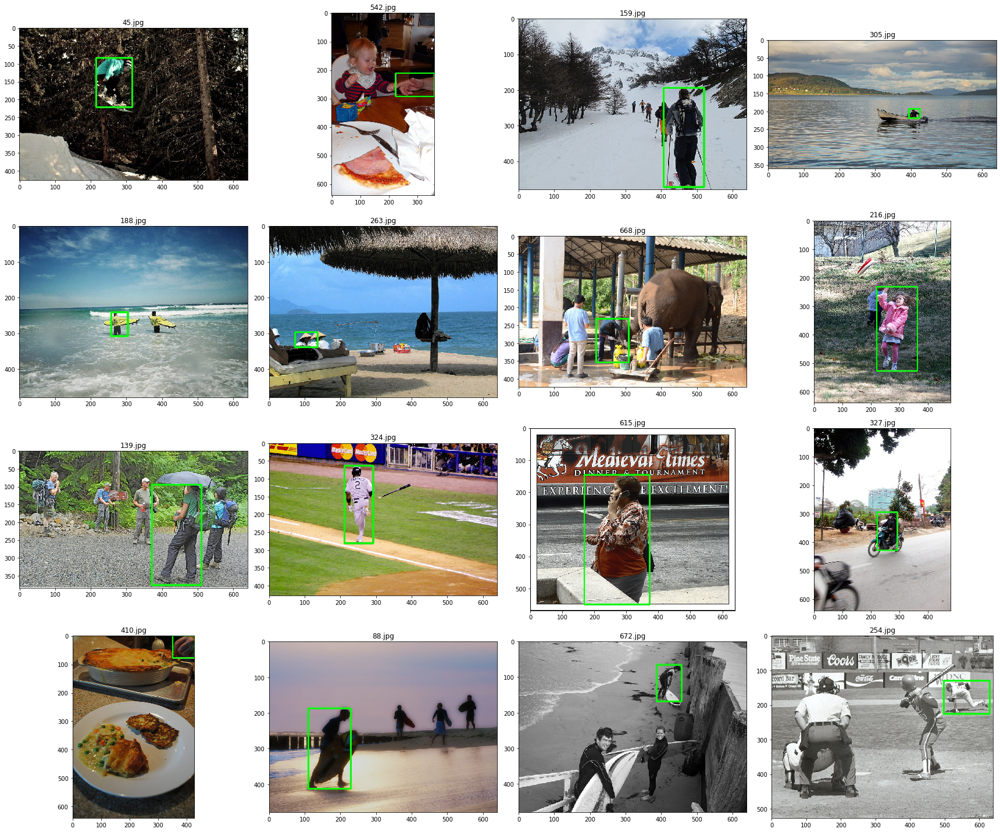

In [113]:
'''show some wrong images'''
photos = random.sample(list(res[res.correct==False].index), 16)
print(res.loc[photos].label)
photos=['{}/{}.jpg'.format(pilot3_path+'/photos/',p) for p in photos]
helper_dataset.draw_photos_from_path(photos, col_size=4)

In [114]:
get_same_img_indices([89,67,131,615,646,194,641,627,119,70,324], mapping_coco)

defaultdict(list,
            {516712: [89, 289, 489, 689, 889],
             153827: [67, 402, 737],
             577659: [131, 631],
             225530: [615],
             415790: [146, 646],
             106521: [194, 394, 594, 794, 994],
             453195: [141, 641],
             536964: [292, 627, 962],
             198476: [119, 319, 519, 719, 919],
             340220: [70],
             197069: [124, 324, 524, 724, 924]})

In [115]:
res.loc[[124, 324, 524, 724, 924]]

/nfs/juhu/data/rakhasan/keras-env/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike
  """Entry point for launching an IPython kernel.


,label,predicted,correct
photo_no,,,
124,0.0,0.0,True
324,1.0,0.0,False
524,0.0,0.0,True
724,NaN,NaN,NaN
924,NaN,NaN,NaN


In [49]:
mapping = pickle.load(open(os.path.join(pilot3_path, 'mappings_common.pkl'), 'rb'))

In [37]:
photos = [i for i in random.sample(range(len(mapping)),9)]
print(photos)
photos=['{}/{}.jpg'.format(pilot3_path+'/photos/',p) for p in photos]
helper_dataset.draw_photos_from_path(photos, col_size=3)

NameError: name 'mapping' is not defined

### Find images for slide show

In [4]:
mapping_coco = pickle.load(open(os.path.join(pilot3_path, 'mappings_common.pkl'), 'rb'))
mapping_google = pickle.load(open(os.path.join(pilot2_path, 'mappings_common.pkl'), 'rb'))

In [5]:
from collections import defaultdict

def get_same_img_indices(idx,mapping):
#idx=[24,118,183,433,988,777,713,708]
    same_img=defaultdict(list)
    for i in idx:
        imageId = mapping[i]['imageId']
        for m in mapping:
            if m['imageId']==imageId:
                same_img[imageId].append(m['index'])
    return same_img

In [81]:
get_same_img_indices([587], mapping_coco)
mapping_coco[252]

{'imageId': 535289,
 'index': 252,
 'fileName': 'COCO_train2014_000000535289.jpg',
 'bbox': [320.72, 480.0, 0.0, 476.92]}

In [34]:
'''Find same image for all google image'''
obvious=[829,938,1019,1042,4410]
#idx=[78,130,220,245,252,325,322,350,506,608,805,901,1107,1139,1198,1447,1687,1724,1829,2646,2991]
idx=[850]
very_hard=[4914,4811,4757,4670,4518]
solo=[4947]
out_of_focus=[4936,4686,4145]
same_img = get_same_img_indices(idx, mapping_google)
same_img

defaultdict(list, {'03354db5d57c47e8': [850, 1495, 2615, 4606]})

In [26]:
'''copy google images'''
# from shutil import copyfile
# root='/data/rakhasan/bystander-detection/google-img-db/home/ec2-user/train_0'
# for item in mapping_google:
#     for d in [root+str(i) for i in range(9)]:
#         if os.path.exists(root+item['fileName']):
#             copyfile(root+item['fileName'], '/data/rakhasan/bystander-detection/google-images/'+item['fileName'])
#             break

In [26]:
from os.path import join
google_img_base_path='/nfs/juhu/data/rakhasan/bystander-detection/google-img-db/home/ec2-user/'
def get_paths(filenames):
    out=dict()
    for f in filenames:
        for d in [join(google_img_base_path, 'train_0'+str(i)) for i in range(0,9)]:
            path=join(d,f)
            #print(path)
            if os.path.isfile(path):
                out[f]=path
    return out

In [28]:
filenames =[m['fileName'] for m in mapping_google]
paths = get_paths(filenames)

In [30]:
from shutil import copyfile

In [40]:
images = [x+'.jpg' for x in get_same_img_indices(obvious,mapping_google).keys()]
for p in images:
    copyfile(paths[p], join('/nfs/juhu/data/rakhasan/bystander-detection/slide-images/',p))

In [41]:
images= [220, 1932, 4409, 4602, 4940]#[1724, 2313, 2753, 4444]#[ 1877, 2277, 3624]#[506, 1280, 2429]
get_same_img_indices([506,350], mapping_google)

defaultdict(list,
            {'06d04900b62d0f30': [506, 1280, 2429],
             '057e2eab5c4131b2': [350, 1996, 3136, 3293, 4437]})

In [85]:
coco_path='/nfs/juhu/data/rakhasan/bystander-detection/coco-dataset/'
for m in mapping_coco:
    copyfile(coco_path+'/images2014/'+m['fileName'], coco_path+'/used-photos/'+m['fileName'])

In [56]:
train_df = pd.read_pickle(os.path.join(pilot2_path, 'predicted-concepts-df-2020-1-12.pkl'))
train_df.index=train_df.index.astype(int)
test_df = pd.read_pickle(os.path.join(pilot3_path, 'predicted-concepts-df.pkl'))
#test_df.loc[images]

In [57]:
test_df=train_df.loc[[506, 1280, 2429]]
train_df=train_df.drop(images)

In [58]:
predictions = clf.predict(test_df.loc[images][predictors])
res = test_df.loc[images][['label']]
res['predicted']=predictions
res['correct']=res.apply(lambda row: row.predicted==row.label,axis=1)
res

KeyError: "None of [Int64Index([220, 1932, 4409, 4602, 4940], dtype='int64', name='photo_no')] are in the [index]"

In [ ]:
photos=['{}/{}.jpg'.format(pilot2_path+'/photos/',p) for p in [850, 1495, 2615, 4606]]
helper_dataset.draw_photos_from_path(photos, col_size=3)

5 1


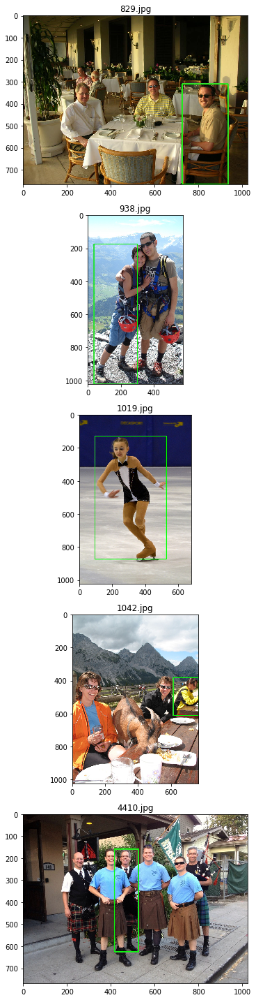

In [17]:
photos=['{}/{}.jpg'.format(pilot2_path+'/photos/',p) for p in obvious]
helper_dataset.draw_photos_from_path(photos, col_size=1)

7 3


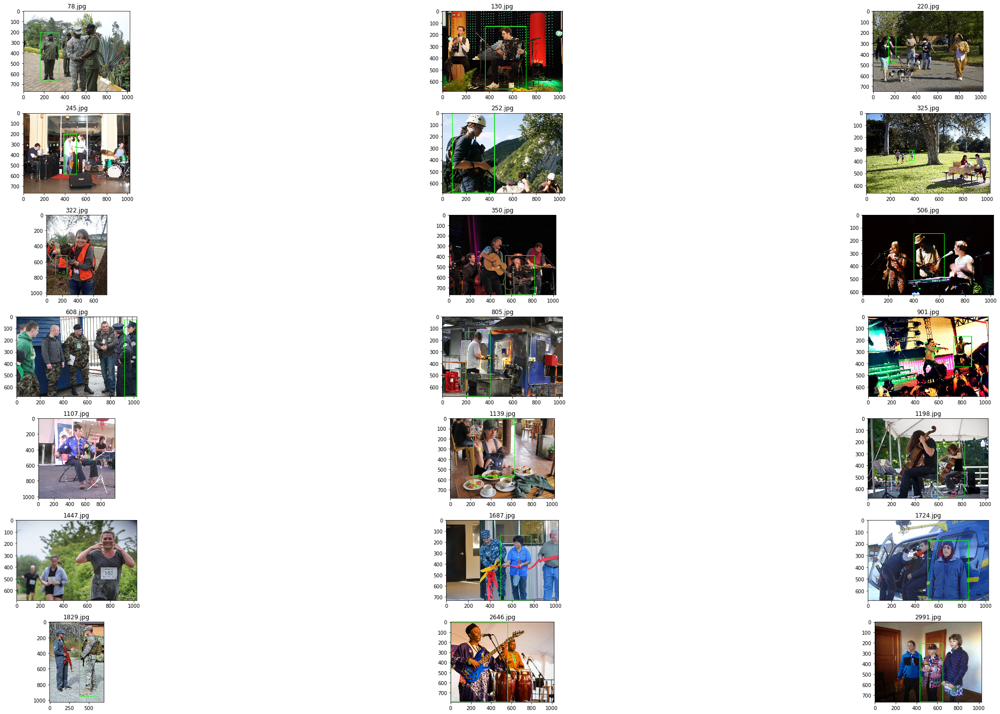

In [409]:
photos=['{}/{}.jpg'.format(pilot2_path+'/photos/',p) for p in idx]
helper_dataset.draw_photos_from_path(photos, col_size=3)

## Get some images with low agreement

In [3]:
ag67 = pickle.load(open(pilot2_path+'/agreement23.pkl','rb'))

1 3


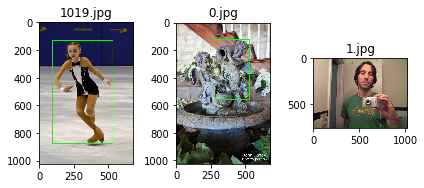

In [45]:
to_show=[str(i) for i in [260,3815,3826,377,1065,4749,3455,2446,1545,4986,3793,1553,526,1604,3643,4959,4002]]

photos=['{}/{}.jpg'.format(pilot2_path+'/photos/',p) for p in [1019,0,1]]
helper_dataset.draw_photos_from_path(photos, col_size=3)

3 3


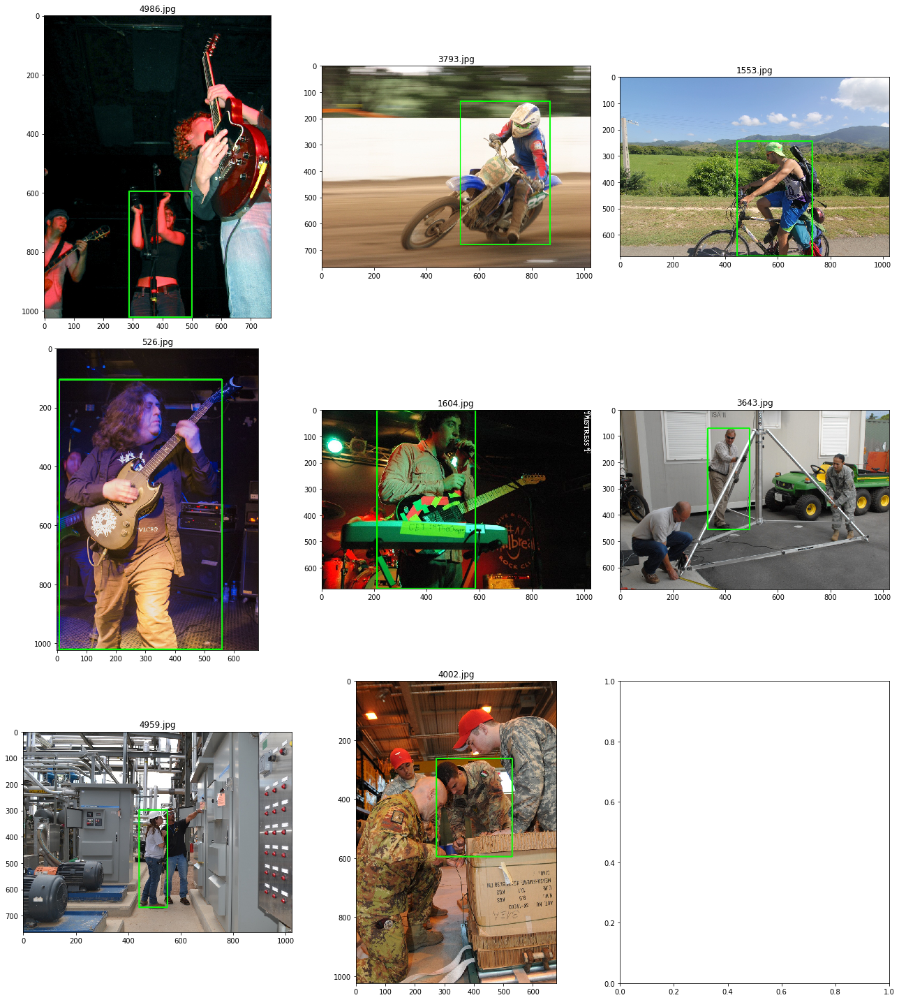

In [19]:
photos=['{}/{}.jpg'.format(pilot2_path+'/photos/',p) for p in to_show[9:]]
helper_dataset.draw_photos_from_path(photos, col_size=3)

In [22]:
df = pd.read_pickle(os.path.join(pilot2_path, 'predicted-concepts-df-2020-1-12.pkl'))
df.loc[to_show][['label']]

,label
photo_no,
260,0
3815,0
3826,1
377,0
1065,1
4749,1
3455,1
2446,1
1545,1


In [34]:
train_df = pd.read_pickle(os.path.join(pilot2_path, 'predicted-concepts-df-2020-1-12.pkl'))
train_df.index=train_df.index.astype(int)
images=[260,3815,3826,377,1065,4749,1545]
test_df=train_df.loc[images]
train_df=train_df.drop(images)

In [35]:
clf = LogisticRegression(random_state=0).fit(train_df[predictors], train_df.label)
predictions = clf.predict(test_df.loc[images][predictors])

res = test_df.loc[images][['label']]
res['predicted']=predictions
res['correct']=res.apply(lambda row: row.predicted==row.label,axis=1)
res

/nfs/juhu/data/rakhasan/keras-env/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)


,label,predicted,correct
photo_no,,,
260,0,0,True
3815,0,0,True
3826,1,0,False
377,0,1,False
1065,1,0,False
4749,1,1,True
1545,1,1,True


In [36]:
images

[260, 3815, 3826, 377, 1065, 4749, 1545]

In [46]:
photos

['/nfs/juhu/data/rakhasan/bystander-detection/pilot-study2//photos//1019.jpg',
 '/nfs/juhu/data/rakhasan/bystander-detection/pilot-study2//photos//0.jpg',
 '/nfs/juhu/data/rakhasan/bystander-detection/pilot-study2//photos//1.jpg']